In [35]:
import argparse
import os
import ee
import ee.mapclient
import fiona
import rasterio
from shapely.geometry import Polygon, LineString
from skimage import measure, draw
from shapely import ops
import pandas
import numpy as np
import geemap as geemap
import shutil
from natsort import natsorted
from matplotlib import pyplot as plt

In [36]:
# ee.Authenticate()
ee.Initialize()

In [37]:
def getSurfaceWater(year, polygon):
    sw = ee.ImageCollection("JRC/GSW1_3/YearlyHistory")

    begin = str(year) + f'-01' + '-01'
    end = str(year) + f'-12' + f'-31'

    return sw.filterDate(
        begin, end
    ).median().clip(
        polygon
    )

In [45]:
def pull_esa(polygon_path, out_root):
    years = [i for i in range(1985, 2020)]

    polygon_name = polygon_path.split('/')[-1].split('.')[0]

    out_paths = {}
    with fiona.open(polygon_path, layer=polygon_name) as layer:
        for feature in layer:
            geom = feature['geometry']
            river = feature['properties']['River']
            out_paths[river] = []
            for year in years:
                print(year)
                poly = ee.Geometry.Polygon(geom['coordinates'])

                river_root = out_root.format(river)
                os.makedirs(river_root, exist_ok=True)

                year_root = os.path.join(river_root, 'temps')
                os.makedirs(year_root, exist_ok=True)
                image = getSurfaceWater(year, poly)
                out_path = os.path.join(
                    year_root,
                    f'{river}_{year}.tif'
                )

                geemap.ee_export_image(
                    image,
                    filename=out_path,
                    scale=30,
                    file_per_band=False
                )
                downloaded = os.path.exists(out_path)

                if downloaded:
                    out_paths[river].append(out_path)
                else:
                    print()
                    print()
                    print('Not Downloaded')
                    print()
                    print()


    for key, item in out_paths.items():
        out_paths[key] = natsorted(item)

    return out_paths


In [46]:
def clean_esa(paths):
    images = {}
    metas = {}
    for river, fps in paths.items():
        images[river] = {}
        metas[river] = {}
        for fp in fps:
            year = fp.split('_')[-1].split('.')[0]
            ds = rasterio.open(fp)
            image = ds.read(1)

            water = image > 1

            dsmeta = ds.meta
            dsmeta.update(
                width=water.shape[1],
                height=water.shape[0],
                count=1,
                dtype=rasterio.int8
            )

            images[river][year] = water
            metas[river][year] = dsmeta

    return images, metas

In [47]:
def create_mask(images):
    # Create Complete mask
    masks = {}
    for river, years in images.items():
        if not len(years):
            continue
        for year, im in years.items():
            im = im.astype(int)
            if int(year) == 1985:
                masks[river] = im
            else:
                masks[river] = np.add(masks[river], im)
        masks[river][masks[river] > 0] = 1

    return masks


def cleanChannel(masks, thresh=3000):
    clean_masks = {}
    for river, mask in masks.items():
        print(river)
        labels = measure.label(mask)
        # assume at least 1 CC
        assert(labels.max() != 0)
        # Find largest connected component
        channel = labels == np.argmax(np.bincount(labels.flat)[1:])+1
        channel = fillHoles(channel, thresh)

        labels = measure.label(channel)
        # assume at least 1 CC
        assert(labels.max() != 0)
        # Find largest connected component
        clean_masks[river] = labels == np.argmax(
            np.bincount(labels.flat)[1:]
        ) + 1

    return clean_masks


def fillHoles(mask, thresh):
    # Find contours
    contours = measure.find_contours(mask, 0.8)
    # Display the image and plot all contours found
    for contour in contours:
        # Get polygon
        poly = draw.polygon(contour[:, 0], contour[:, 1])
        if (len(poly[0]) == 0) or (len(poly[1]) == 0):
            continue
        area = (
            (poly[0].max() - poly[0].min() + 1)
            * (poly[1].max() - poly[1].min() + 1)
        )
        # Filter by size
        if area < thresh:
            draw.set_color(
                mask,
                poly,
                True
            )

    return mask


def crop_raster(raster, channel_belt):
    raster[np.where(channel_belt != 1)] = 0

    return raster


In [48]:
def get_mobility_stats(j, A, channel_belt, baseline,
                       step, step1, step2, fb, dt=1):
    # Calculate D - EQ. (1)
    D = np.sum(np.abs(np.subtract(baseline, step)))

    # Calculate D / A
    D_A = D / A

    # Calculate Phi
    w_b = len(np.where(baseline == 1)[0])
    w_t = len(np.where(step == 1)[0])

    fw_b = w_b / A
    fw_t = w_t / A
    fd_b = (A - w_b) / A
    fd_t = (A - w_t) / A

    PHI = (fw_b * fd_t) + (fd_b * fw_t)

    # Calculate O_Phi
    O_PHI = 1 - (D / (A * PHI))

    # Calculate Np
    fb = fb - step
    Nb = len(np.where(fb == 1)[0])

    # THIS CALCULATION IS INCORRECT
    # Calculate fr
    fR = 1 - (Nb / (A * fd_b))

    # Calculate D(B+2) - D(B+1)
    DB2_DB1 = np.sum(np.abs(np.subtract(step1, step2)))

    # Calculate Zeta dt = 1
    zeta = DB2_DB1 / (2 * A * dt)

    return D, D_A, PHI, O_PHI, fR, zeta, fb, fw_b, fd_b


In [49]:
def get_mobility_yearly(images, clean_channel_belts, year_range):
    river_dfs = {}
    for i, (river, all_years) in enumerate(images.items()):
        if not len(all_years):
            continue
        data = {
            'year': [],
            'i': [],
            'D': [],
            'D/A': [],
            'Phi': [],
            'O_Phi': [],
            'fR': [],
            'zeta': [],
            'fw_b': [],
            'fd_b': [],
        }
        print()
        print(river)

        channel_belt = clean_channel_belts[river]

        # Find A
        A = len(np.where(channel_belt == 1)[1])

        # Combine the year steps
        all_images = []
        years = []
        for year in year_range:
            years.append(year)
            all_images.append(all_years[str(year)])

        for j, im in enumerate(all_images):
            where = np.where(~channel_belt)
            im[where] = 0
            # Get the baseline
            if j == 0:
                baseline = im.astype(int)

            # Get step
            step = im.astype(int)
            if j < len(all_images) - 2:
                step1 = all_images[j+1].astype(int)
                step2 = all_images[j+2].astype(int)
            else:
                step1 = np.zeros(step1.shape)
                step2 = np.zeros(step2.shape)

            if j == 0:
                fb = channel_belt - baseline

            D, D_A, PHI, O_PHI, fR, zeta, fb, fw_b, fd_b = get_mobility_stats(
                j,
                A,
                channel_belt,
                baseline,
                step,
                step1,
                step2,
                fb
            )

            data['i'].append(i)
            data['D'].append(D)
            data['D/A'].append(D_A)
            data['Phi'].append(PHI)
            data['O_Phi'].append(O_PHI)
            data['fR'].append(fR)
            data['zeta'].append(zeta)
            data['fw_b'].append(fw_b)
            data['fd_b'].append(fd_b)
        data['year'] = years
        river_dfs[river] = pandas.DataFrame(data=data)

    return river_dfs 


In [79]:
polygon_path = '/Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1.gpkg'
out_root = '/Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/{}'
year_range = [i for i in range(1990, 2020)]
river = 'Ganges1'

In [80]:
paths = pull_esa(polygon_path, out_root)
images, metas = clean_esa(paths)
channel_belts = create_mask(images)
clean_channel_belts = cleanChannel(channel_belts, 100000)
river_dfs = get_mobility_yearly(
    images,
    clean_channel_belts,
    year_range
)

for river, df in river_dfs.items():
    df['dt'] = pandas.to_datetime(
        df['year'],
        format='%Y'
    )
    river_dfs[river] = df

1985
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/temps/Ganges1_1985.tif
1986
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/temps/Ganges1_1986.tif
1987
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/temps/Ganges1_1987.tif
1988
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/temps/Ganges1_1988.tif
1989
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/temps/Ganges1_1989.tif
1990
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/temps/Ganges1_1990.tif
1991
Generating URL ...
Please wait ...
Data downloaded to /Users/gree

Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/temps/Ganges1_2009.tif
2010
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/temps/Ganges1_2010.tif
2011
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/temps/Ganges1_2011.tif
2012
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/temps/Ganges1_2012.tif
2013
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/temps/Ganges1_2013.tif
2014
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/temps/Ganges1_2014.tif
2015
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GI

Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges2/temps/Ganges2_1999.tif
2000
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges2/temps/Ganges2_2000.tif
2001
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges2/temps/Ganges2_2001.tif
2002
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges2/temps/Ganges2_2002.tif
2003
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges2/temps/Ganges2_2003.tif
2004
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges2/temps/Ganges2_2004.tif
2005
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GI

Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/temps/Ganges3_1989.tif
1990
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/temps/Ganges3_1990.tif
1991
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/temps/Ganges3_1991.tif
1992
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/temps/Ganges3_1992.tif
1993
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/temps/Ganges3_1993.tif
1994
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/temps/Ganges3_1994.tif
1995
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GI

Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/temps/Ganges3_2014.tif
2015
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/temps/Ganges3_2015.tif
2016
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/temps/Ganges3_2016.tif
2017
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/temps/Ganges3_2017.tif
2018
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/temps/Ganges3_2018.tif
2019
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/temps/Ganges3_2019.tif
1985
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GI

Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges4/temps/Ganges4_2004.tif
2005
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges4/temps/Ganges4_2005.tif
2006
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges4/temps/Ganges4_2006.tif
2007
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges4/temps/Ganges4_2007.tif
2008
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges4/temps/Ganges4_2008.tif
2009
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges4/temps/Ganges4_2009.tif
2010
Generating URL ...
Please wait ...
Data downloaded to /Users/greenberg/Documents/PHD/Projects/Mobility/GI

In [81]:
for river, df in river_dfs.items():
    df.to_csv(
        os.path.join(
            out_root.format(river), 
            f'{river}_yearly_mobility.csv'
        )
    )

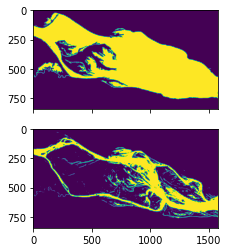

In [117]:
fig, axs = plt.subplots(2,1, sharex=True, sharey=True)
axs[0].imshow(clean_channel_belts['Ganges4'])
axs[1].imshow(images['Ganges4']['1990'])
plt.show()

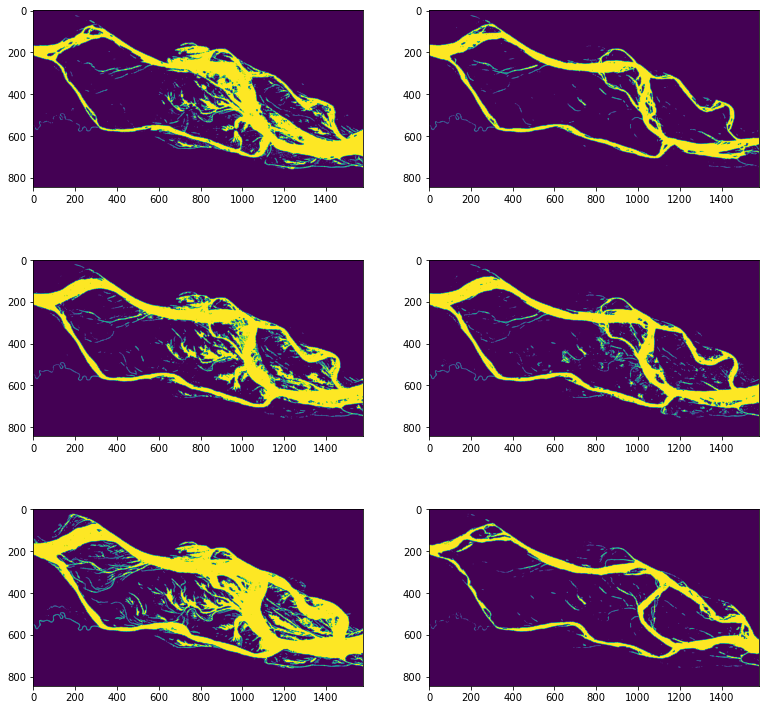

In [133]:
fig, axs = plt.subplots(3, 2, figsize=(13,13))
i = 0
for year in images['Ganges4']:
    if (int(year) < 1990) or (int(year) > 1995):
        continue
    axs.ravel()[i].imshow(images['Ganges4'][year])
    i += 1
plt.show()

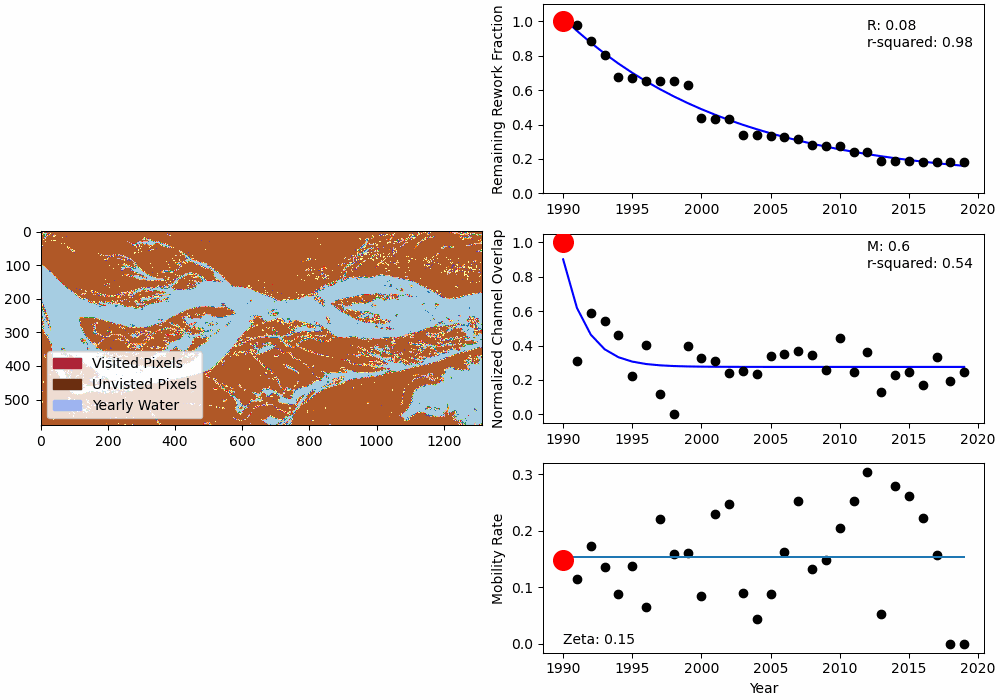

In [89]:
from IPython.display import Image
path = '/Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges1/Ganges1_cumulative.gif'
Image(path)

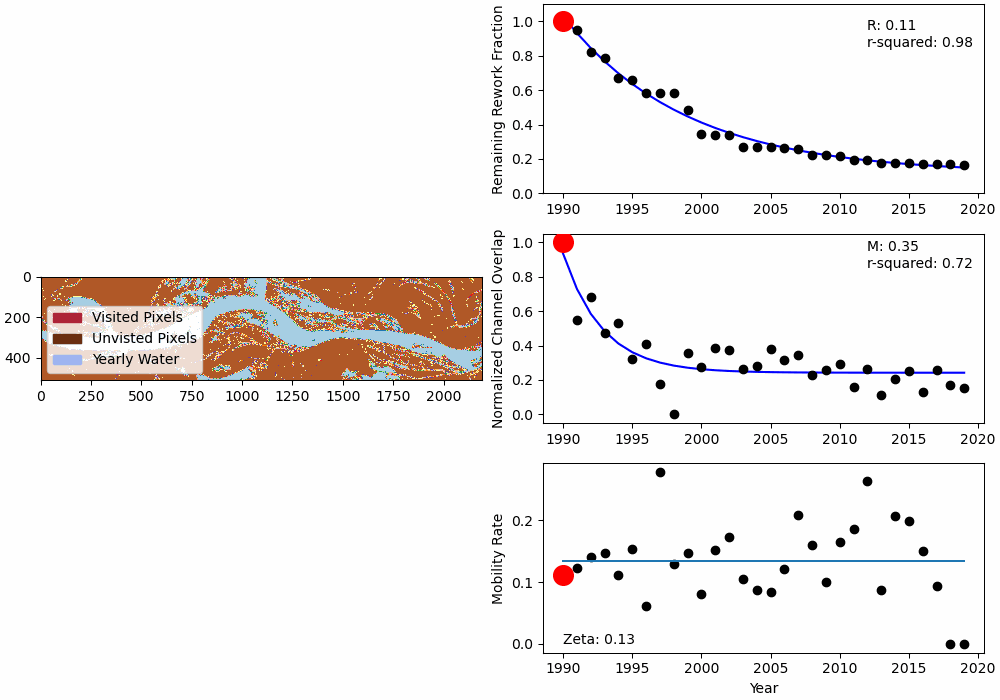

In [88]:
path = '/Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges2/Ganges2_cumulative.gif'
Image(path)

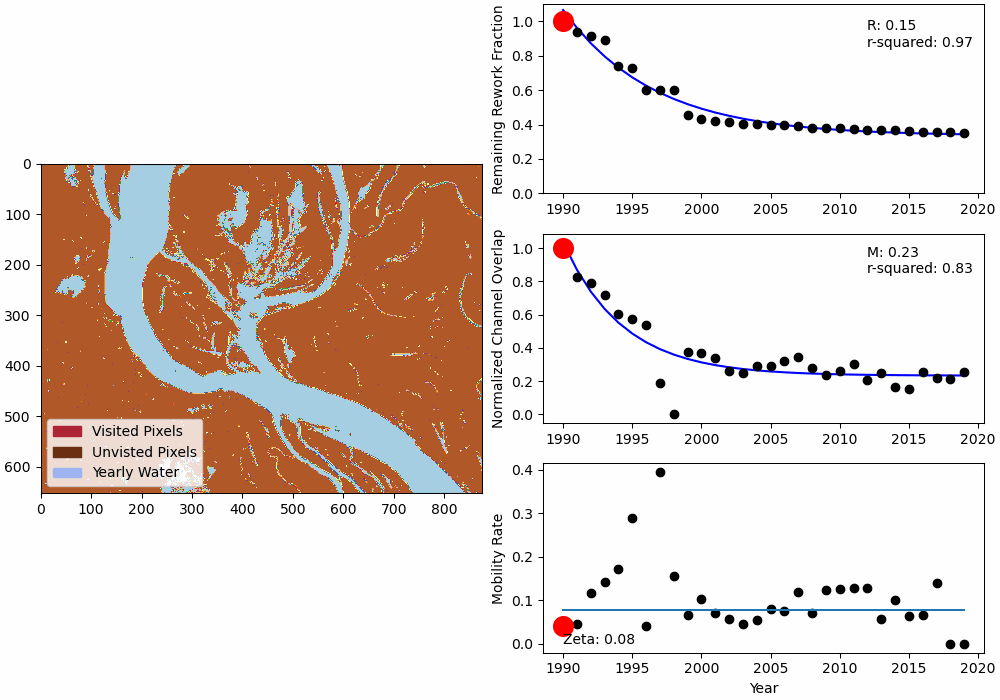

In [91]:
path = '/Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges3/Ganges3_cumulative.gif'
Image(path)

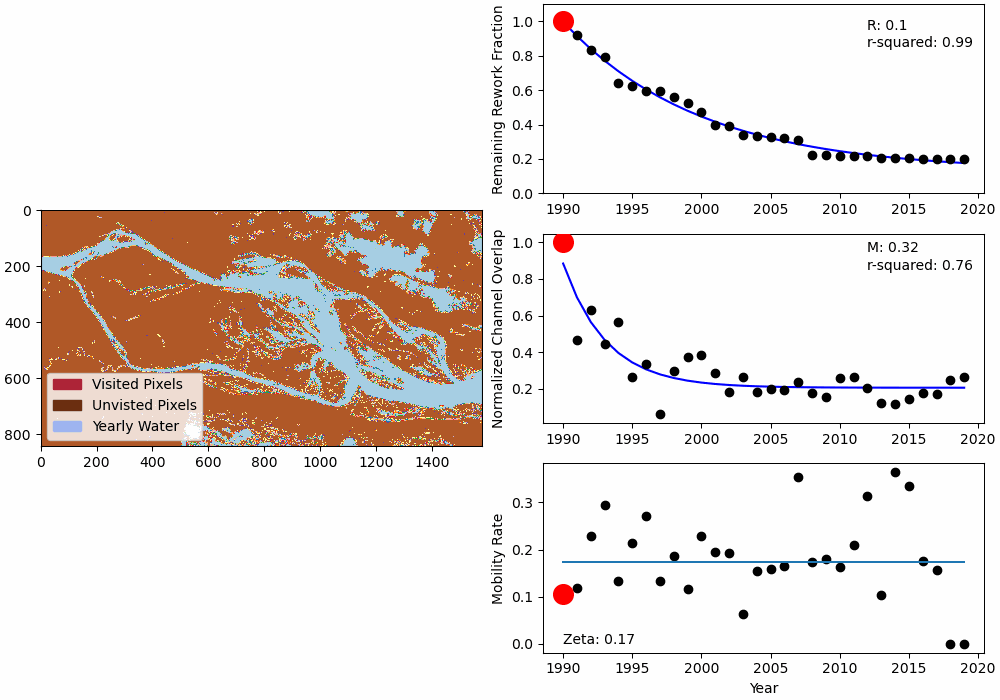

In [87]:
path = '/Users/greenberg/Documents/PHD/Projects/Mobility/GIS/Development/Ganges4/Ganges4_cumulative.gif'
Image(path)

In [103]:
from scipy.optimize import curve_fit


def func(x, a, m, p):
    return ((a - p) * np.exp(-m * x)) + p


def fit_curve(x, y):
    # Fitting
    popt, pcov = curve_fit(func, x, y, p0=[1, .00001, 0], maxfev=1000)
    # R-squared
    residuals = y - func(x, *popt)
    ss_res = np.sum(residuals**2)
    ss_tot = np.sum((y - np.mean(y))**2)
    r_squared = 1 - (ss_res / ss_tot)

    return (*popt), r_squared


0.11


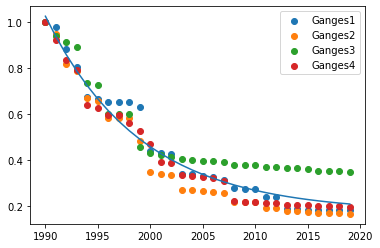

In [114]:
comb_df = pandas.DataFrame()
for river, df in river_dfs.items():
    df = df.reset_index(drop=False)
    comb_df = comb_df.append(df)
    plt.scatter(df['year'], 1 - df['fR'], label=river)
    
ar, r, pr, r2 = fit_curve(comb_df.index, 1 - comb_df['fR'])
ypred = func(df.index, ar, r, pr)
plt.plot(df['year'], ypred)
plt.legend()
print(round(r,2))